## Instructions

1. Input continuous BGR images from webcam.

2. Use <i>MediaPipe()</i> to detect and track one of your hands.

3. Obtain the positions of 21 HandLandmarks.

4. Design an algorithm to recognize three hand gestures of Rock, Scissor, Paper.

5. Use <i>cv2.putText()</i> to write the type of the recognized hand gesture on the upper left corner.

6. Show your output images.

7. Upload your Jupyter code file (*.ipynb)

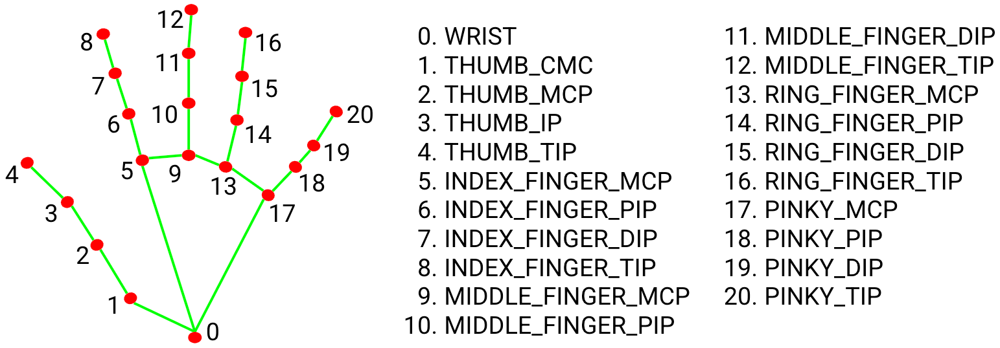

In [1]:
#hand tracking using MeidaPipe
#pip install mediapipe
import cv2
import mediapipe as mp

mp_drawing = mp.solutions.drawing_utils
mp_hands = mp.solutions.hands

def getHandMove(hand_landmarks):
    landmarks = hand_landmarks.landmark
    if all([landmarks[i].y < landmarks[i+3].y for i in range(9, 20, 4)]):
        return 'ROCK'
    elif landmarks[13].y < landmarks[16].y and landmarks[17].y < landmarks[20].y:
        return 'SCISSORS'
    else:
        return 'PAPER'


# For webcam input:
cap = cv2.VideoCapture(0)
frameWidth = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
frameHeight = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)

with mp_hands.Hands(
    min_detection_confidence=0.7,
    min_tracking_confidence=0.7) as hands:

  while cap.isOpened():
    success, image = cap.read()
    if not success:
      print("Ignoring empty camera frame.")
      # If loading a video, use 'break' instead of 'continue'.
      continue

    # Flip the image horizontally for a later selfie-view display, and convert
    # the BGR image to RGB.
    image = cv2.cvtColor(cv2.flip(image, 1), cv2.COLOR_BGR2RGB)
    # To improve performance, optionally mark the image as not writeable to
    # pass by reference.
    image.flags.writeable = False     #加速用，無意義
    results = hands.process(image)

    # Draw the hand annotations on the image.
    image.flags.writeable = True
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    if results.multi_hand_landmarks:
      for hand_landmarks in results.multi_hand_landmarks:
        mp_drawing.draw_landmarks(
            image, hand_landmarks, mp_hands.HAND_CONNECTIONS)
        for point in mp_hands.HandLandmark:
            normalizedLandmark = hand_landmarks.landmark[point]
            pixelCoordinatesLandmark = mp_drawing._normalized_to_pixel_coordinates(normalizedLandmark.x, 
                                                            normalizedLandmark.y, frameWidth, frameHeight)
            
            gesture = getHandMove(hand_landmarks)
            
            cv2.putText(image, gesture, (10, 40), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 4, cv2.LINE_AA)

            #cv2.circle(image, pixelCoordinatesLandmark, 5, (0, 255, 0), -1)
            #print(point, pixelCoordinatesLandmark)
    cv2.imshow('MediaPipe Hands', image)
    c = cv2.waitKey(1)
    if c == 27:
        break
cap.release()
cv2.destroyAllWindows()
cv2.waitKey()

INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


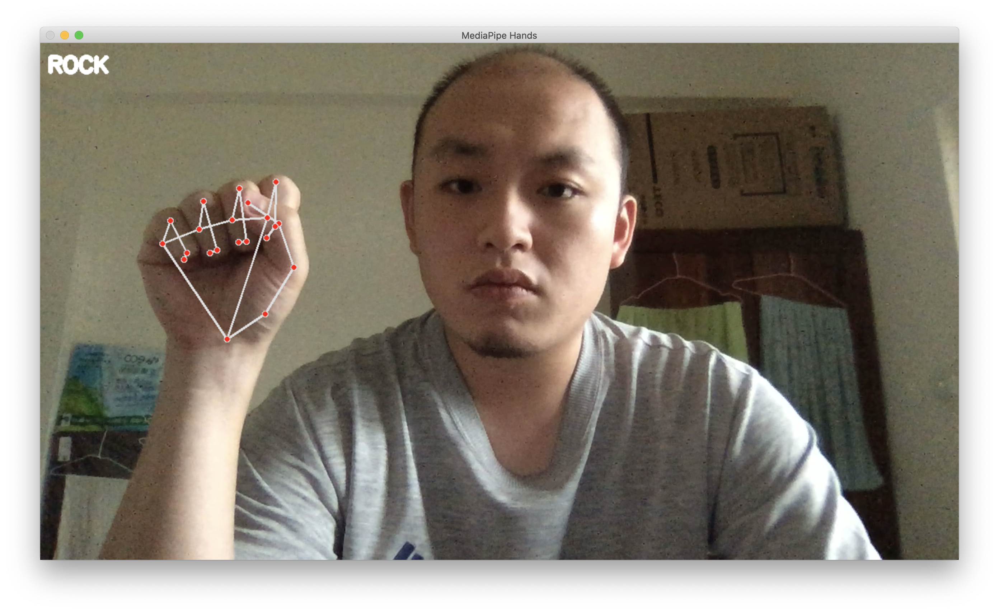

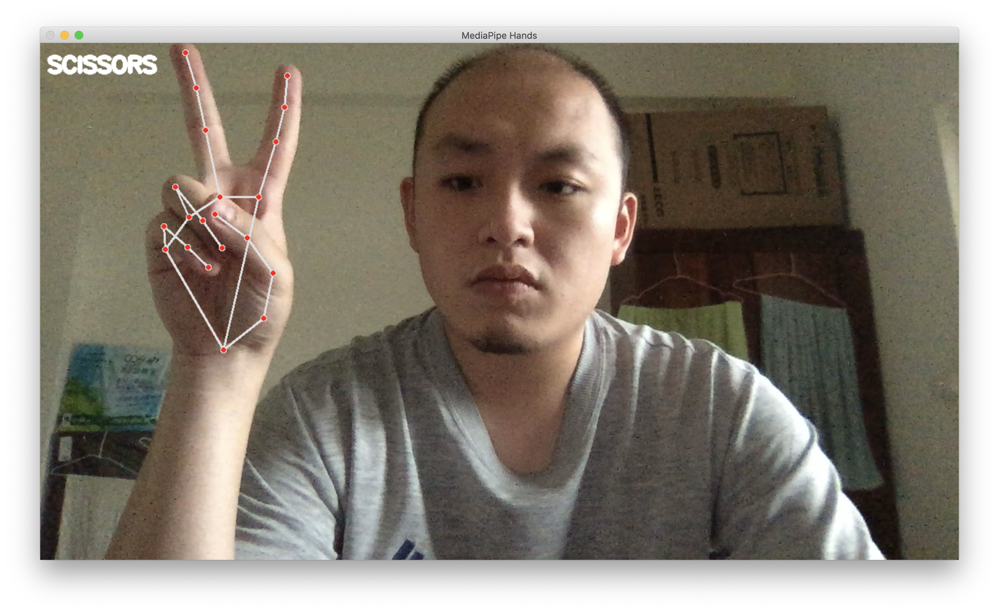

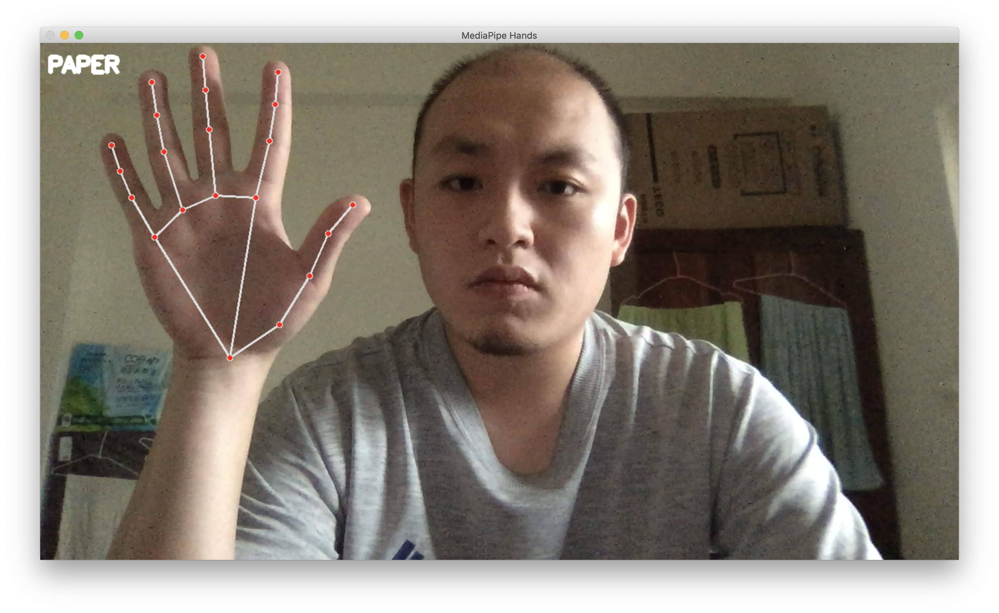